In [9]:
import torch

In [10]:
model_id = "runwayml/stable-diffusion-v1-5"

In [11]:
# %pip install diffusers

In [12]:
from diffusers import StableDiffusionPipeline

pipe = StableDiffusionPipeline.from_pretrained(model_id)

The cache for model files in Transformers v4.22.0 has been updated. Migrating your old cache. This is a one-time only operation. You can interrupt this and resume the migration later on by calling `transformers.utils.move_cache()`.


0it [00:00, ?it/s]

Cannot initialize model with low cpu memory usage because `accelerate` was not found in the environment. Defaulting to `low_cpu_mem_usage=False`. It is strongly recommended to install `accelerate` for faster and less memory-intense model loading. You can do so with: 
```
pip install accelerate
```
.
/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:88: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


model_index.json:   0%|          | 0.00/541 [00:00<?, ?B/s]

Fetching 15 files:   0%|          | 0/15 [00:00<?, ?it/s]

scheduler/scheduler_config.json:   0%|          | 0.00/308 [00:00<?, ?B/s]

safety_checker/config.json:   0%|          | 0.00/4.72k [00:00<?, ?B/s]

tokenizer/merges.txt:   0%|          | 0.00/525k [00:00<?, ?B/s]

(…)ature_extractor/preprocessor_config.json:   0%|          | 0.00/342 [00:00<?, ?B/s]

text_encoder/config.json:   0%|          | 0.00/617 [00:00<?, ?B/s]

unet/config.json:   0%|          | 0.00/743 [00:00<?, ?B/s]

tokenizer/tokenizer_config.json:   0%|          | 0.00/806 [00:00<?, ?B/s]

tokenizer/special_tokens_map.json:   0%|          | 0.00/472 [00:00<?, ?B/s]

vae/config.json:   0%|          | 0.00/547 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/1.22G [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/492M [00:00<?, ?B/s]

tokenizer/vocab.json:   0%|          | 0.00/1.06M [00:00<?, ?B/s]

diffusion_pytorch_model.safetensors:   0%|          | 0.00/3.44G [00:00<?, ?B/s]

diffusion_pytorch_model.safetensors:   0%|          | 0.00/335M [00:00<?, ?B/s]

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

In [13]:
prompt = "portrait photo of a old warrior chief"

In [14]:
pipe = pipe.to("cuda") # GPU 사용을 위해 GPU로 pipeline 이동

In [15]:
generator = torch.Generator("cuda").manual_seed(0) # 모든 call에서 거의 동일한 이미지를 재현할 수 있도록 하기 위해 생성기 사용

  0%|          | 0/50 [00:00<?, ?it/s]

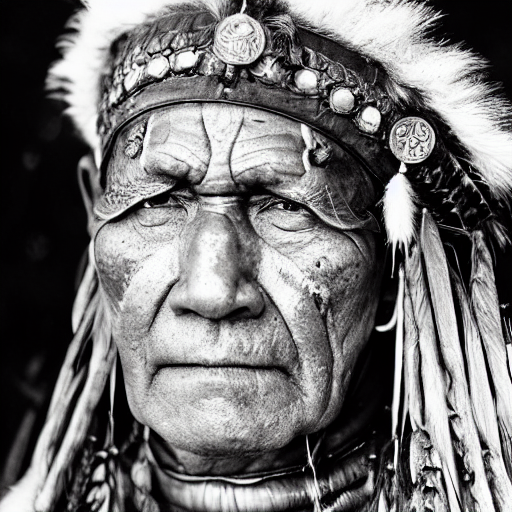

In [16]:
image = pipe(prompt, generator = generator, num_images = 20).images[0]
image

여기까지의 실행은 전체 float32 정밀도를 사용하고 기본 추론 단계 수는 50개로 실행을 했다. 가장 쉽게 속도를 높일 수 있는 방법은 float16 정밀도로 전환하고 추론 단계를 더 적게 실행하는 것이다.

In [17]:
pipe = StableDiffusionPipeline.from_pretrained(model_id, torch_dtype = torch.float16) # 모델 float16으로 로드

Cannot initialize model with low cpu memory usage because `accelerate` was not found in the environment. Defaulting to `low_cpu_mem_usage=False`. It is strongly recommended to install `accelerate` for faster and less memory-intense model loading. You can do so with: 
```
pip install accelerate
```
.


Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

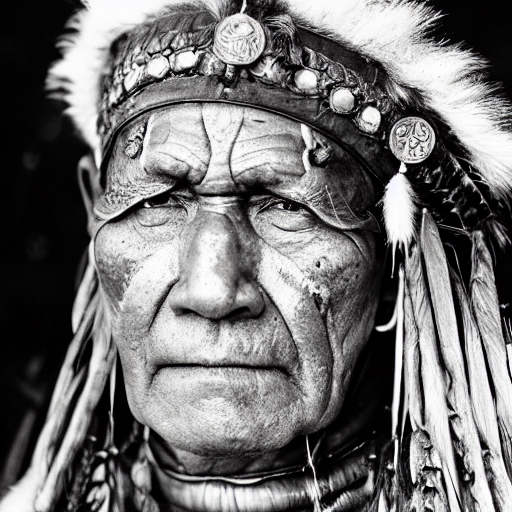

In [18]:
pipe = pipe.to("cuda")
generator = torch.Generator("cuda").manual_seed(0)
image = pipe(prompt, generator = generator).images[0]
image

In [19]:
pipe.scheduler.compatibles

[diffusers.schedulers.scheduling_pndm.PNDMScheduler,
 diffusers.schedulers.scheduling_ddim.DDIMScheduler,
 diffusers.schedulers.scheduling_euler_discrete.EulerDiscreteScheduler,
 diffusers.schedulers.scheduling_dpmsolver_singlestep.DPMSolverSinglestepScheduler,
 diffusers.schedulers.scheduling_unipc_multistep.UniPCMultistepScheduler,
 diffusers.schedulers.scheduling_lms_discrete.LMSDiscreteScheduler,
 diffusers.schedulers.scheduling_deis_multistep.DEISMultistepScheduler,
 diffusers.schedulers.scheduling_euler_ancestral_discrete.EulerAncestralDiscreteScheduler,
 diffusers.schedulers.scheduling_k_dpm_2_discrete.KDPM2DiscreteScheduler,
 diffusers.utils.dummy_torch_and_torchsde_objects.DPMSolverSDEScheduler,
 diffusers.schedulers.scheduling_heun_discrete.HeunDiscreteScheduler,
 diffusers.schedulers.scheduling_dpmsolver_multistep.DPMSolverMultistepScheduler,
 diffusers.schedulers.scheduling_k_dpm_2_ancestral_discrete.KDPM2AncestralDiscreteScheduler,
 diffusers.schedulers.scheduling_edm_eule

  0%|          | 0/20 [00:00<?, ?it/s]

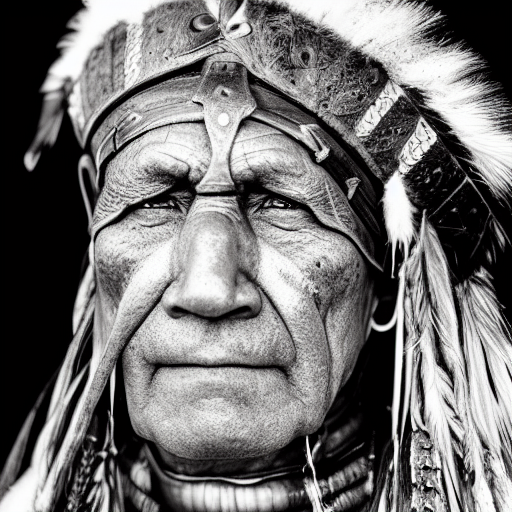

In [20]:
from diffusers import DPMSolverMultistepScheduler

pipe.scheduler = DPMSolverMultistepScheduler.from_config(pipe.scheduler.config)

generator = torch.Generator("cuda").manual_seed(0)

image = pipe(prompt, generator = generator, num_inference_steps = 20).images[0]
image

In [21]:
def get_inputs(batch_size = 1):
  generator = [torch.Generator("cuda").manual_seed(i) for i in range(batch_size)]
  prompts = batch_size * [prompt]
  num_inference_steps = 20

  return {"prompt": prompts, "generator": generator, "num_inference_steps" : num_inference_steps }

In [22]:
batch_size = 1
range(batch_size)

range(0, 1)

In [23]:
from PIL import Image

def image_grid(imgs, rows = 2, cols = 2):
  w, h = imgs[0].size
  grid = Image.new("RGB", size = (cols * w, rows * h))

  for i, img in enumerate(imgs):
    grid.paste(img, box = (i%cols*w, i//cols*h))
  return grid

  0%|          | 0/20 [00:00<?, ?it/s]

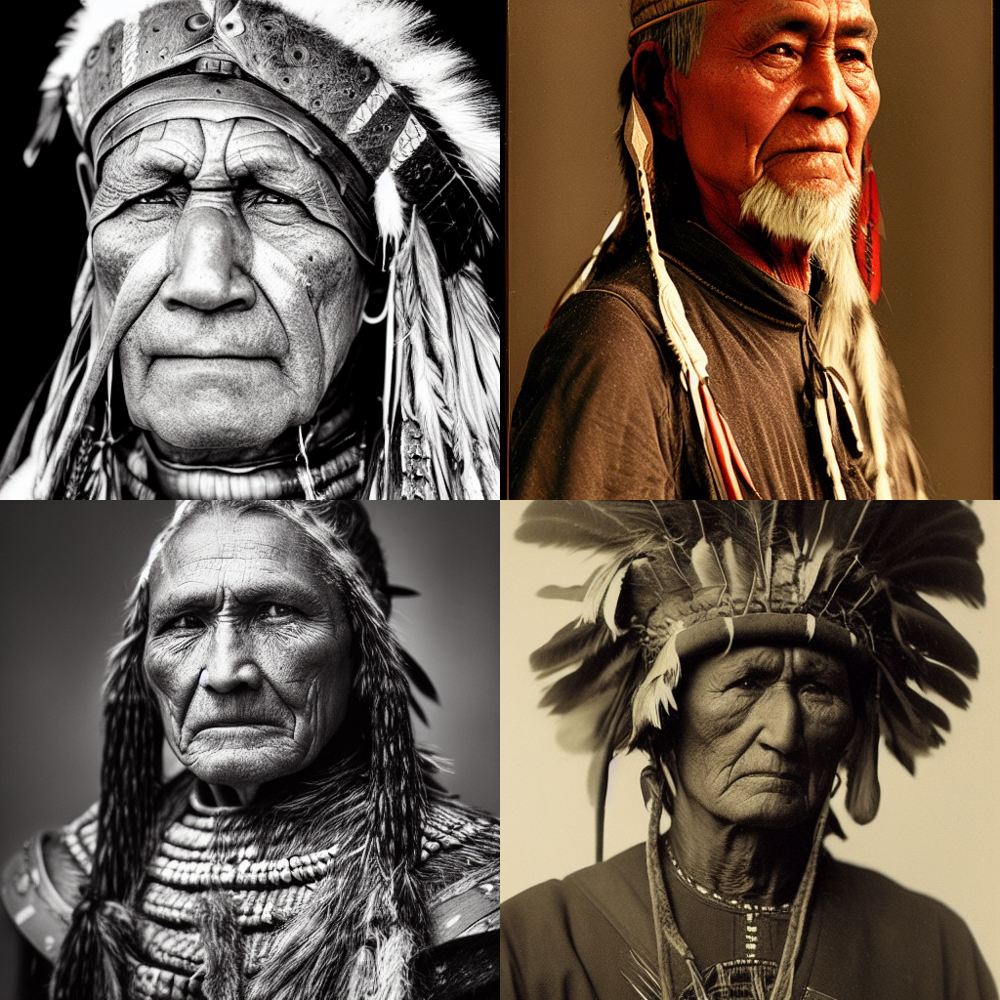

In [24]:
images = pipe(**get_inputs(batch_size = 4)).images
image_grid(images)

In [25]:
pipe.enable_attention_slicing()

  0%|          | 0/20 [00:00<?, ?it/s]

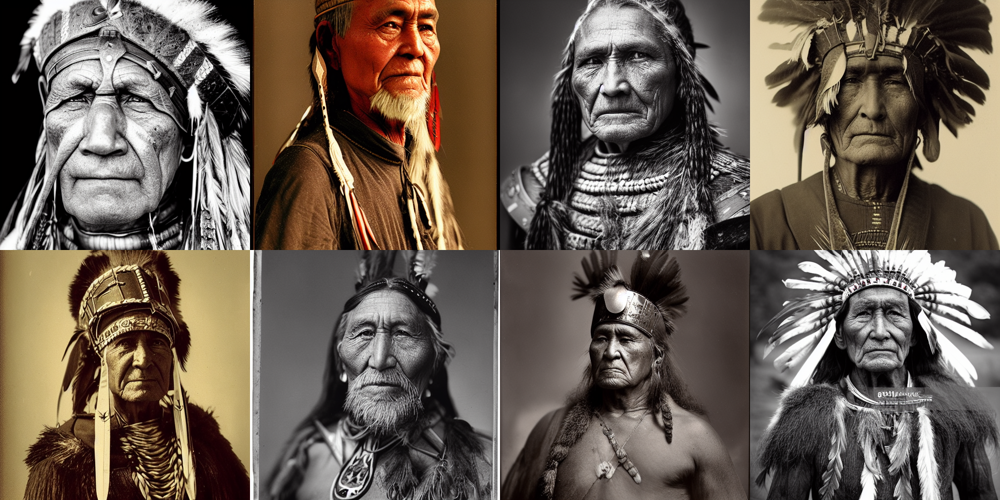

In [26]:
images = pipe(**get_inputs(batch_size = 8)).images
image_grid(images, rows = 2, cols = 4)

In [27]:
from diffusers import AutoencoderKL

In [29]:
vae = AutoencoderKL.from_pretrained("stabilityai/sd-vae-ft-mse", torch_dtype = torch.float16).to("cuda")

Cannot initialize model with low cpu memory usage because `accelerate` was not found in the environment. Defaulting to `low_cpu_mem_usage=False`. It is strongly recommended to install `accelerate` for faster and less memory-intense model loading. You can do so with: 
```
pip install accelerate
```
.


config.json:   0%|          | 0.00/547 [00:00<?, ?B/s]

diffusion_pytorch_model.safetensors:   0%|          | 0.00/335M [00:00<?, ?B/s]

In [30]:
pipe.vae = vae

  0%|          | 0/20 [00:00<?, ?it/s]

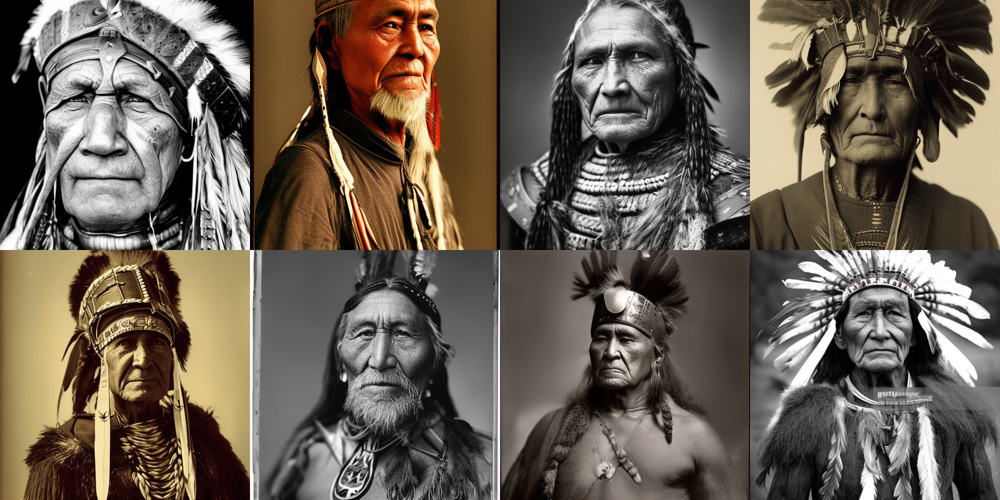

In [31]:
images = pipe(**get_inputs(batch_size = 8)).images
image_grid(images, rows = 2, cols = 4)

In [33]:
# 프롬프트엔지니어링

prompt += ", tribal panther make up, blue on red, side profile, looking away, serious eyes" # detail
prompt += " 50mm portrait photography, hard rim lighting photography--beta --ar 2:3  --beta --upbeta"  # cues
prompt

'portrait photo of a old warrior chief, tribal panther make up, blue on red, side profile, looking away, serious eyes, tribal panther make up, blue on red, side profile, looking away, serious eyes 50mm portrait photography, hard rim lighting photography--beta --ar 2:3  --beta --upbeta'

  0%|          | 0/20 [00:00<?, ?it/s]

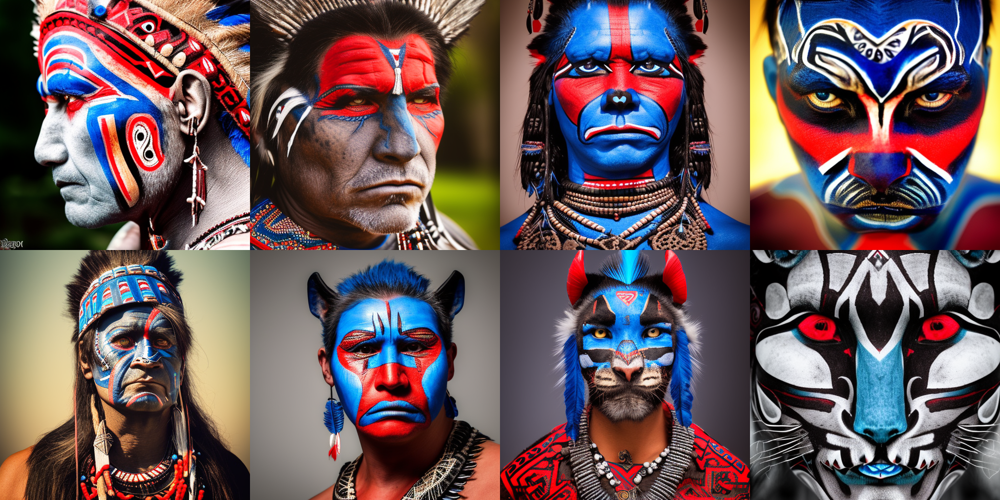

In [35]:
images = pipe(**get_inputs(batch_size=8)).images
image_grid(images, rows = 2, cols = 4)

In [36]:
prompts = [
    "portrait photo of the oldest warrior chief, tribal panther make up, blue on red, side profile, looking away, serious eyes 50mm portrait photography, hard rim ligting photography--beta --ar 2:3  --beta --upbeta",
    "portrait photo of a old warrior chief, tribal panther make up, blue on red, side profile, looking away, serious eyes 50mm portrait photography, hard rim lighting photography--beta --ar 2:3  --beta --upbeta",
    "portrait photo of a warrior chief, tribal panther make up, blue on red, side profile, looking away, serious eyes 50mm portrait photography, hard rim lighting photography--beta --ar 2:3  --beta --upbeta",
    "portrait photo of a young warrior chief, tribal panther make up, blue on red, side profile, looking away, serious eyes 50mm portrait photography, hard rim lighting photography--beta --ar 2:3  --beta --upbeta"
]

generator = [torch.Generator("cuda").manual_seed(1) for _ in range(len(prompts))]

  0%|          | 0/25 [00:00<?, ?it/s]

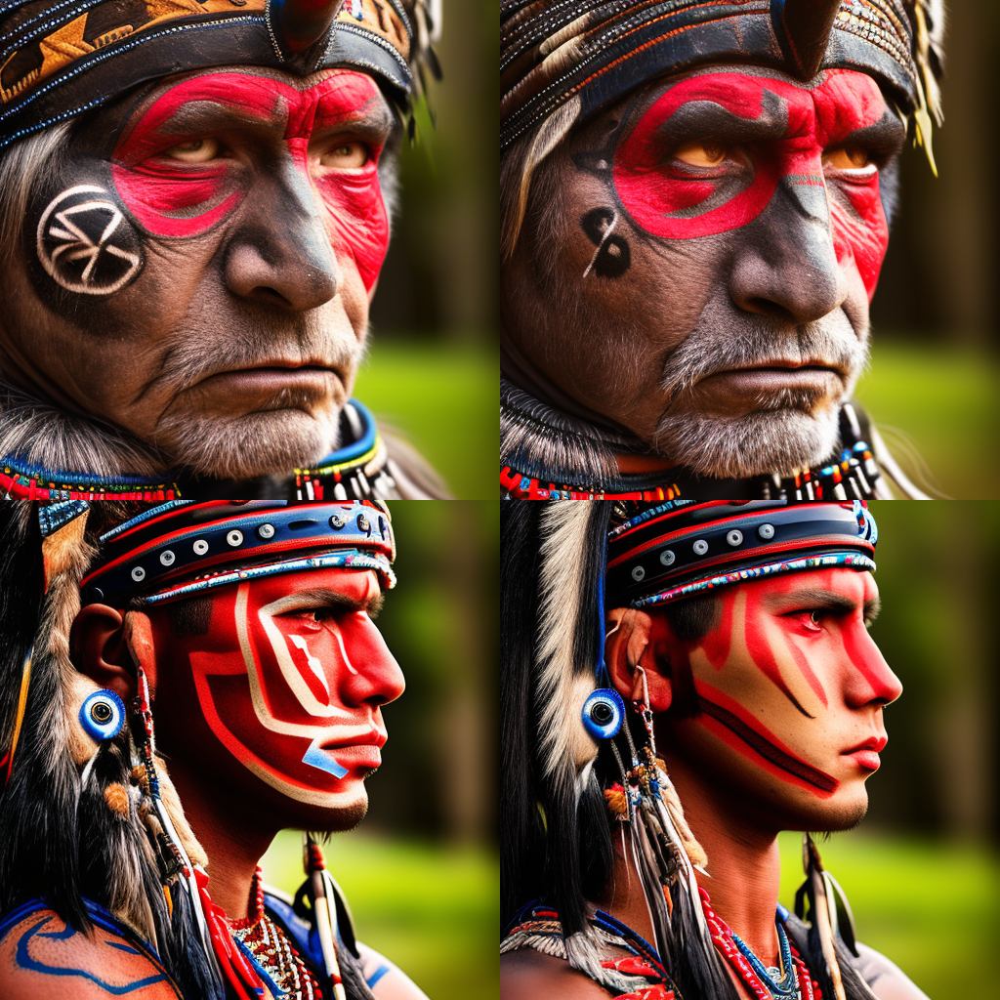

In [38]:
images = pipe(prompt=prompts, generator=generator, num_inference_steps=25).images
image_grid(images)